<a href="https://colab.research.google.com/github/Minh-A/Dacon_ArcticSeaIce_Prediction/blob/main/Dacon_Code_6_DecisionTree.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 랜덤포레스트
> 머신러닝 앙상블 (ensemble) RandomForest
* https://lsjsj92.tistory.com/542?category=853217

> 배깅(Bagging), 보팅(Voting), 부스팅(Boosting)
* RandomForest는 배깅(Bagging)에 속함
* https://wikidocs.net/26294


# Xgboost 모델
> 머신러닝 앙상블 (ensemble) Xgboost
* https://lsjsj92.tistory.com/547

In [ ]:
# 파이토치 라이브러리 임포트
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings(action='ignore')
import torch
import torch.nn as nn
import torch.nn.functional as F

import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Dataset,DataLoader, TensorDataset
from torch.autograd import Variable  # 자동미분기능 제공
import torch.optim as optim
import matplotlib.pyplot as plt
import matplotlib.pyplot

from tqdm import tqdm  # 진행표시바

import xgboost as xgb ## XGBoost 불러오기
from xgboost import plot_importance ## Feature Importance를 불러오기 위함

# np.random.seed(777)
# torch.manual_seed(777)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")  # GPU, CPU 선택
print('CPU? GPU? : ', device)

CPU? GPU? :  cuda:0


In [ ]:
# 구글드라이브 연결
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
fn = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train.csv')
fn.tail()

,month,file_nm
477,2018-08,201808.npy
478,2018-09,201809.npy
479,2018-10,201810.npy
480,2018-11,201811.npy
481,2018-12,201812.npy


In [ ]:
# fn.iloc[351:,1]  # 200801
fn.iloc[423:,1].head()

423    201402.npy
424    201403.npy
425    201404.npy
426    201405.npy
427    201406.npy
Name: file_nm, dtype: object

In [ ]:
# 120개를 향해
# 3년만
dm = fn.iloc[351:,1]
dm.shape

(131,)

In [ ]:
# 데이터 생성
data = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/200801.npy')
data = data.reshape(1,448,304,5)

for i in tqdm(dm):
    a = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/'+i)
    a = a.reshape(1,448,304,5)

    data = np.concatenate((data,a), axis=0)
data = np.array(data)
data = data[:,:,:,0]

data.shape

100%|██████████| 131/131 [00:02<00:00, 63.98it/s]


(132, 448, 304)

In [ ]:
# 데이터 셋 만들기

# 데이터 셋 형태 변환
data = data.reshape(132,1, 448,304)

# 월별로 데이터 셋 생성
for i in tqdm(range(12)):
  # globals()['train{}'.format(i)] = np.array(np.concatenate((data[0+i], data[12+i], data[24+i], data[36+i], data[48+i]), axis=0))
  globals()['train{}'.format(i)] = np.array(np.concatenate((data[0+i], data[12+i], data[24+i], data[36+i], data[48+i], data[60+i], data[72+i], data[84+i], data[96+i], data[108+i], data[120+i]), axis=0))

  # globals()['train{}'.format(i)] = np.array(np.concatenate((data[0+i], data[12+i], data[24+i], data[36+i], data[48+i], data[60+i], data[72+i], data[84+i], data[96+i], data[108+i], data[120+i],
  #                                                           data[132+i], data[144+i], data[156+i], data[168+i], data[180+i], data[192+i], data[204+i], data[216+i], data[228+i]), axis=0))

  print("\n",globals()['train{}'.format(i)].shape)  # globals()는 그 변수를 의미 - 없으면 그냥 문자열

100%|██████████| 12/12 [00:00<00:00, 444.73it/s]


 (11, 448, 304)

 (11, 448, 304)

 (11, 448, 304)

 (11, 448, 304)

 (11, 448, 304)

 (11, 448, 304)

 (11, 448, 304)

 (11, 448, 304)

 (11, 448, 304)

 (11, 448, 304)

 (11, 448, 304)

 (11, 448, 304)


In [ ]:
x_train = train3[:10].reshape(10,-1).T
y_train = train3[10].reshape(1,-1).T
x_test = train3[1:11].reshape(10,-1).T

------
> 모델 뚱땅뚱땅 중

In [ ]:
import xgboost as xgb ## XGBoost 불러오기
from xgboost import plot_importance ## Feature Importance를 불러오기 위함

In [ ]:
x_train.shape

(136192, 10)

In [ ]:
xgb_model = xgb.XGBRegressor(n_estimators=200, learning_rate=0.07, gamma=0, subsample=0.75,
                           colsample_bytree=1, max_depth=7)


xgb_model.fit(x_train,y_train)

[08:02:50] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.07, max_delta_step=0,
             max_depth=7, min_child_weight=1, missing=None, n_estimators=200,
             n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
             silent=None, subsample=0.75, verbosity=1)

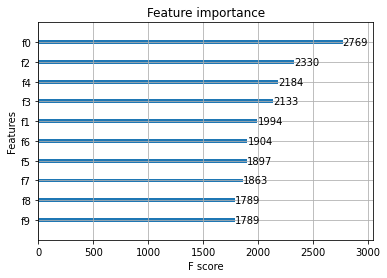

In [ ]:
xgb.plot_importance(xgb_model)

In [ ]:
xgb_model.score(x_train, y_train)

0.9984330872301636

In [ ]:
predictions = xgb_model.predict(x_train)
predictions

array([0.01060945, 0.01060945, 0.01060945, ..., 0.01060945, 0.01060945,
       0.01060945], dtype=float32)

In [ ]:
x_train.shape

(136192, 10)

In [ ]:
predictions.shape

(136192,)

In [ ]:
predictions.reshape(448,304)

array([[0.01060945, 0.01060945, 0.01060945, ..., 0.01060945, 0.01060945,
        0.01060945],
       [0.01060945, 0.01060945, 0.01060945, ..., 0.01060945, 0.01060945,
        0.01060945],
       [0.01060945, 0.01060945, 0.01060945, ..., 0.01060945, 0.01060945,
        0.01060945],
       ...,
       [0.01060945, 0.01060945, 0.01060945, ..., 0.01060945, 0.01060945,
        0.01060945],
       [0.01060945, 0.01060945, 0.01060945, ..., 0.01060945, 0.01060945,
        0.01060945],
       [0.01060945, 0.01060945, 0.01060945, ..., 0.01060945, 0.01060945,
        0.01060945]], dtype=float32)

In [ ]:
# 에헴 함수
def fun(x) : 
    return np.round_(x, 0)

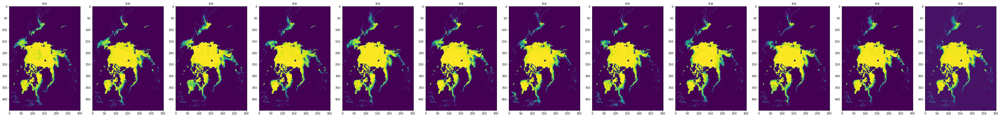

In [ ]:
show(np.concatenate((train3, fun(predictions.reshape(1,448,304)))))

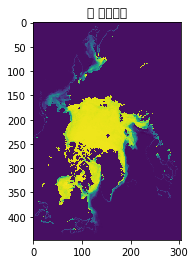

In [ ]:
# 전처리된 데이터 확인
import matplotlib.pyplot
matplotlib.pyplot.imshow(fun(predictions.reshape(448,304)), interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')
matplotlib.pyplot.show()

In [ ]:
predictions.reshape(448,304)[250,200]

219.96892

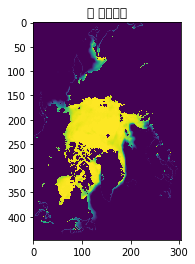

In [ ]:
# 전처리된 데이터 확인
import matplotlib.pyplot
matplotlib.pyplot.imshow(train0[4].reshape(448,304), interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')
matplotlib.pyplot.show()

In [ ]:
train0[4].reshape(448,304)[250,200]

163

> 모델 뚱땅뚱땅 끝
--------

> SVC
* https://chancoding.tistory.com/67
* https://blog.naver.com/taewwon/221598401726

In [ ]:
# Fitting SVR to the dataset
from sklearn.svm import SVR
regressor = SVR(kernel = 'rbf',)
regressor.fit(x_train, y_train)

SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [ ]:
y_pred = regressor.predict(x_test)

In [ ]:
y_pred

array([0.09972087, 0.09972087, 0.09972087, ..., 0.09972087, 0.09972087,
       0.09972087])

In [ ]:
# 에헴 함수
def fun(x) : 
    return np.round_(x, 0)

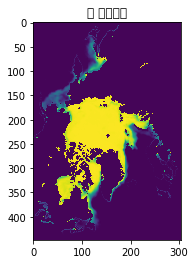

In [ ]:
# 전처리된 데이터 확인
import matplotlib.pyplot
matplotlib.pyplot.imshow(fun(y_pred.reshape(448,304)), interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')
matplotlib.pyplot.show()

In [ ]:
# 그래프 함수
def show(npy):
    num_channel = npy.shape[0]
    plt.figure(figsize=(50, 50)) 
    for channel in range(num_channel):
      tmpimg = npy[channel, :, :]
      ax = plt.subplot(1, num_channel, channel+1)  # (행, 열, 데이터 개수) - 그리고 싶은 팜플렛
      ax.title.set_text("Ice")

      ax.imshow(tmpimg)
    plt.tight_layout()
    plt.show()
    plt.close()

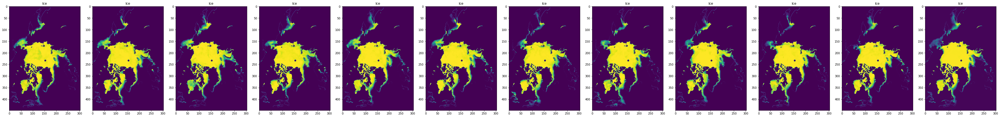

In [ ]:
show(np.concatenate((train3, fun(y_pred.reshape(1,448,304)))))

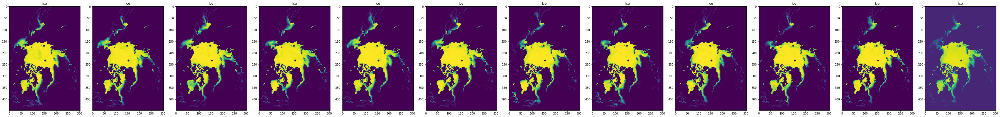

In [ ]:
# rbf
show(np.concatenate((train3, fun(y_pred.reshape(1,448,304)))))

In [ ]:
#Linear SVM을 위한 적절한 C값  검색
#분류:SVC, 회귀(예측):SVR
from sklearn.svm import SVR

scores = []
for thisC in tqdm(range(1,100)):
    svc=SVR(kernel='poly',C=thisC)
    model=svc.fit(x_train,y_train)
    scoreTrain=model.score(x_train,y_train)
    print("poly SVM : C:{}, training score:{:2f}".format
          (thisC,scoreTrain))
    scores.append([scoreTrain])

  0%|          | 0/99 [00:00<?, ?it/s]

In [ ]:
train0[:4].shape

(4, 448, 304)

In [ ]:
# 이동 데이터 셋 만들기

# 월별로 데이터 셋 생성
for i in tqdm(range(12)):
  a = globals()['train{}'.format(i)]
  globals()['mvtrain_{}'.format(i)] = np.array(np.concatenate(((a[1] - a[0]).reshape(1, 448,304), (a[2] - a[1]).reshape(1, 448,304), (a[3] - a[2]).reshape(1, 448,304), (a[4] - a[3]).reshape(1, 448,304),
                                                               (a[5] - a[4]).reshape(1, 448,304), (a[6] - a[5]).reshape(1, 448,304), (a[7] - a[6]).reshape(1, 448,304), (a[8] - a[7]).reshape(1, 448,304),
                                                               (a[9] - a[8]).reshape(1, 448,304), (a[10] - a[9]).reshape(1, 448,304)), axis=0))

  print("\n",globals()['mvtrain_{}'.format(i)].shape)  # globals()는 그 변수를 의미 - 없으면 그냥 문자열


100%|██████████| 12/12 [00:00<00:00, 652.15it/s]


 (10, 448, 304)

 (10, 448, 304)

 (10, 448, 304)

 (10, 448, 304)

 (10, 448, 304)

 (10, 448, 304)

 (10, 448, 304)

 (10, 448, 304)

 (10, 448, 304)

 (10, 448, 304)

 (10, 448, 304)

 (10, 448, 304)


In [ ]:
train_0[1:4].shape

(3, 448, 304)

SVR 모델

In [ ]:
# SVR 모델
from sklearn.svm import SVR

for i in range(12):
  datan = globals()['mvtrain_{}'.format(i)]

  # 데이터셋 나누기
  x_train = datan[:3].reshape(3,-1).T
  y_train = datan[3].reshape(1,-1).T
  x_test = datan[1:4].reshape(3,-1).T

  # 모델 훈련
  regressor = SVR(kernel = 'rbf', C = 1)
  regressor.fit(x_train, y_train)

  # 모델 예측
  predictions = regressor.predict(x_test)

  # 소수점은 다 사라져 함수 생성
  # def fun(x) : 
  #   return np.round_(x, 0)

  # 소숫점 버리기
  def fun(x) : 
    return np.trunc(x)

  # 그래프를 보자구
  plt.imshow(fun(predictions.reshape(448,304)), interpolation = 'None')
  plt.show()

  # 변수 저장
  globals()['pred{}'.format(i)] = fun(predictions)
  print(globals()['pred{}'.format(i)].shape)


In [ ]:
pred11

array([0., 0., 0., ..., 0., 0., 0.])

In [ ]:
# fun 함수의 마이너스 확인
def fun(x) : 
    return np.round_(x, 0)

fun(-1), fun(-0.5), fun(-10.77)

(-1, -0.0, -11.0)

  0%|          | 0/12 [00:00<?, ?it/s]

(136192,)


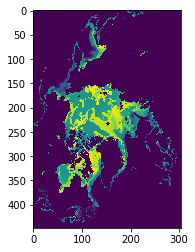

  8%|▊         | 1/12 [00:00<00:01,  5.88it/s]

(136192,)


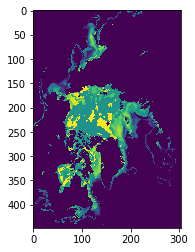

 17%|█▋        | 2/12 [00:00<00:01,  5.77it/s]

(136192,)


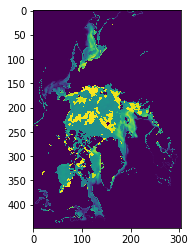

 25%|██▌       | 3/12 [00:00<00:01,  5.54it/s]

(136192,)


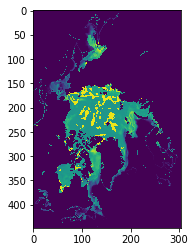

 33%|███▎      | 4/12 [00:00<00:01,  5.34it/s]

(136192,)


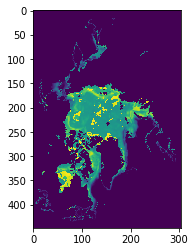

 42%|████▏     | 5/12 [00:00<00:01,  5.32it/s]

(136192,)


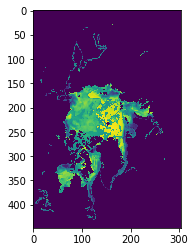

 50%|█████     | 6/12 [00:01<00:01,  5.24it/s]

(136192,)


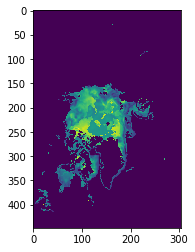

 58%|█████▊    | 7/12 [00:01<00:00,  5.22it/s]

(136192,)


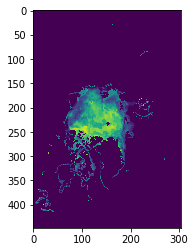

 67%|██████▋   | 8/12 [00:01<00:00,  4.55it/s]

(136192,)


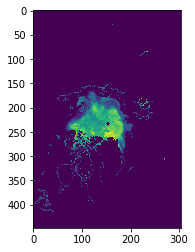

 75%|███████▌  | 9/12 [00:01<00:00,  4.74it/s]

(136192,)


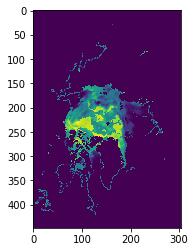

 83%|████████▎ | 10/12 [00:02<00:00,  4.85it/s]

(136192,)


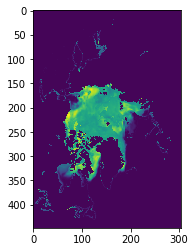

 92%|█████████▏| 11/12 [00:02<00:00,  4.99it/s]

(136192,)


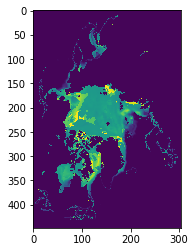

100%|██████████| 12/12 [00:02<00:00,  5.00it/s]


In [ ]:
# 변동성의 합
for i in tqdm(range(12)):
  ori = globals()['train{}'.format(i)][4].reshape(-1)
  pr = globals()['pred{}'.format(i)]

  globals()['mvpred_{}'.format(i)] = ori + pr
  print(globals()['mvpred_{}'.format(i)].shape)

  # 그래프를 보자구
  plt.imshow(globals()['mvpred_{}'.format(i)].reshape(448,304), interpolation = 'None')
  plt.show()

In [ ]:
x = mvtrain_0[:9].reshape(9,-1).T
y = mvtrain_0[9].reshape(1,-1).T

In [ ]:
x.shape, y.shape

((136192, 9), (136192, 1))

In [ ]:
x[50000].shape

(9,)

In [ ]:
y

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=uint8)

In [ ]:
import lightgbm as lgb
train_ds = lgb.Dataset(pd.DataFrame(x), label= pd.DataFrame(y))

params = {
            'learning_rate' : 0.05,
            'boosting_type': 'gbdt',
            'objective': 'tweedie',
            'tweedie_variance_power': 1.1,
            'metric': 'rmse',
            'sub_row' : 0.75,
            'lambda_l2' : 0.1
        }

model = lgb.train(params,
                  train_ds,
                  1000
                 )

In [ ]:
pred = model.predict(pd.DataFrame(x))

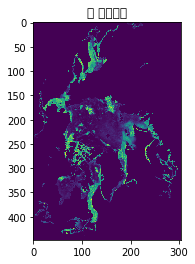

In [ ]:
# 전처리된 데이터 확인
import matplotlib.pyplot
matplotlib.pyplot.imshow(pred.reshape(448,304), interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')
matplotlib.pyplot.show()

In [ ]:
# ARIMA 모델
import lightgbm as lgb

for i in range(12):
  datan = globals()['mvtrain_{}'.format(i)]
  datan = datan.reshape(10,-1).T

  a = globals()['prediction{}'.format(i)] = []

  for j in tqdm(range(136192)):
    train = datan[j]

    model = auto_arima(train)

    a.append(model.predict(n_periods=1))

  a = np.array(a).T
  print(a.shape)

  # 그래프를 보자구
  plt.imshow(fun(predictions.reshape(448,304)), interpolation = 'None')
  plt.show()

In [ ]:
p = mvtrain_0.reshape(10,-1).T
p.shape

(136192, 10)

In [ ]:
p[50000]

array([246,   2,   2,   3,   2, 254,   2,   1, 251,   4], dtype=uint8)

In [ ]:
from statsmodels.tsa.ar_model import AR
train = p[50000]
model = AR(train)
model_fit = model.fit()
model_fit.predict()

array([  1., 251.,   4.])

In [ ]:
!pip install pmdarima
from pmdarima.arima import auto_arima

In [ ]:
model = auto_arima(train)
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   10
Model:               SARIMAX(1, 0, 1)   Log Likelihood                 -59.381
Date:                Wed, 17 Mar 2021   AIC                            126.761
Time:                        04:59:23   BIC                            127.972
Sample:                             0   HQIC                           125.434
                                 - 10                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     61.7802     45.910      1.346      0.178     -28.201     151.762
ar.L1          0.0972      0.659      0.148      0.883      -1.194       1.388
ma.L1         -0.9899     20.498     -0.048      0.961     -41.165      39.185
sigma2      6806.4859   1.37e+05      0.050      0.960   -2.61e+05    2.75e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):                 0.58
Prob(Q):                              0.93   Prob(JB):                         0.75
Heteroskedasticity (H):               0.98   Skew:                             0.16
Prob(H) (two-sided):                  0.99   Kurtosis:                         1.86
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
a = []
a.append(model.predict(n_periods=1))
a.append(model.predict(n_periods=1))
np.array(a)

array([[38.79260149],
       [38.79260149]])

In [ ]:
train

array([246,   2,   2,   3,   2, 254,   2,   1, 251,   4], dtype=uint8)

In [ ]:
p[50000]

array([246,   2,   2,   3,   2, 254,   2,   1, 251,   4], dtype=uint8)

In [ ]:
# ARIMA 모델
from pmdarima.arima import auto_arima

for i in range(12):
  datan = globals()['mvtrain_{}'.format(i)]
  datan = datan.reshape(10,-1).T

  a = globals()['prediction{}'.format(i)] = []

  for j in tqdm(range(136192)):
    train = datan[j]

    model = auto_arima(train)

    a.append(model.predict(n_periods=1))

  a = np.array(a).T
  print(a.shape)

  # 그래프를 보자구
  plt.imshow(fun(predictions.reshape(448,304)), interpolation = 'None')
  plt.show()

 14%|█▎        | 18672/136192 [12:30<8:13:28,  3.97it/s]

KeyboardInterrupt: ignored

In [ ]:
# 예측 변동률
pred.reshape(448,304)[250,200]

138.66880617605992

In [ ]:
# 전 값에 더한 최종값
mvtrain_0[3].reshape(448,304)[250,200]

236

In [ ]:
(train0[4] - train0[3])[250,200]

236

In [ ]:
train0[4][250,200], train0[3][250,200]

(219, 239)

In [ ]:
train0[3][250,200], train0[2][250,200]

(239, 187)

In [ ]:
train0[2][250,200], train0[1][250,200]

(187, 208)

In [ ]:
train0[1][250,200], train0[0][250,200]

(208, 182)

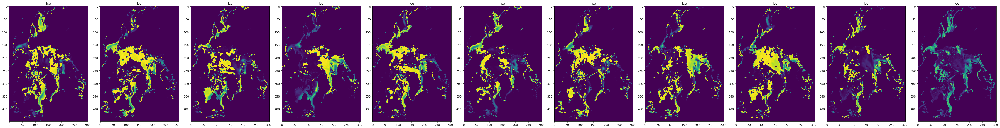

In [ ]:
show(np.concatenate((mvtrain_0, pred.reshape(1,448,304))))

In [ ]:
import lightgbm as lgb

params = { 
          'boosting_type': 'gbdt', 'metric': 'mae', 'subsample': 0.5, 'subsample_freq': 1, 'learning_rate': 0.05
        }

In [ ]:
pd.DataFrame(y_train)

,0
0,0
1,0
2,0
3,0
4,0
...,...
136187,0
136188,0
136189,0
136190,0


In [ ]:
train_ds = lgb.Dataset(pd.DataFrame(x_train), label= pd.DataFrame(y_train))
train_ds

In [ ]:
model = lgb.train(params, train_ds, 1000, verbose_eval = 1000)
model

In [ ]:
pred = model.predict(pd.DataFrame(x_test))
pred

array([0.01145324, 0.01145324, 0.01145324, ..., 0.01145324, 0.01145324,
       0.01145324])

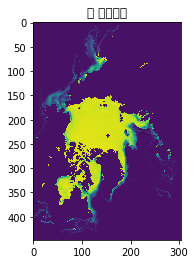

In [ ]:
# 전처리된 데이터 확인
import matplotlib.pyplot
matplotlib.pyplot.imshow(fun(pred.reshape(448,304)), interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')
matplotlib.pyplot.show()

LGB 모델


  0%|          | 0/12 [00:00<?, ?it/s]

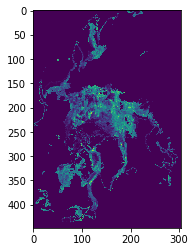


  8%|▊         | 1/12 [00:19<03:36, 19.72s/it]

(136192,)


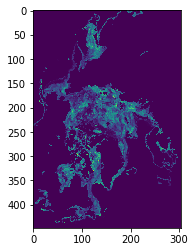


 17%|█▋        | 2/12 [00:39<03:18, 19.85s/it]

(136192,)


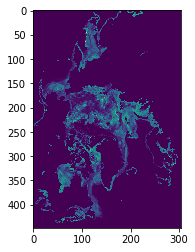


 25%|██▌       | 3/12 [01:00<03:00, 20.01s/it]

(136192,)


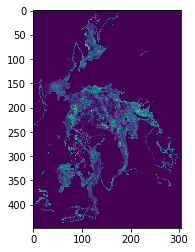


 33%|███▎      | 4/12 [01:20<02:40, 20.03s/it]

(136192,)


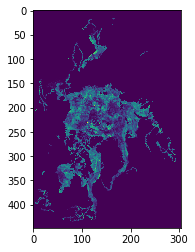


 42%|████▏     | 5/12 [01:39<02:19, 19.88s/it]

(136192,)


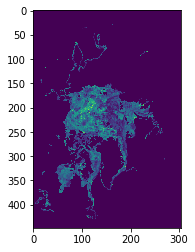


 50%|█████     | 6/12 [01:59<01:58, 19.76s/it]

(136192,)


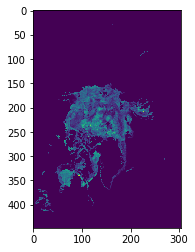


 58%|█████▊    | 7/12 [02:18<01:37, 19.44s/it]

(136192,)


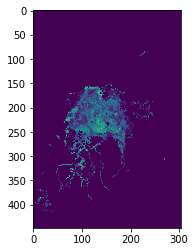


 67%|██████▋   | 8/12 [02:35<01:15, 18.80s/it]

(136192,)


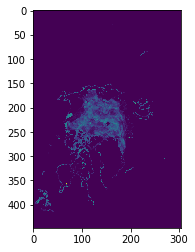


 75%|███████▌  | 9/12 [02:52<00:54, 18.25s/it]

(136192,)


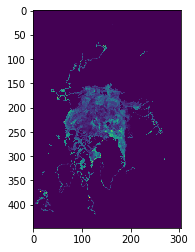


 83%|████████▎ | 10/12 [03:10<00:36, 18.20s/it]

(136192,)


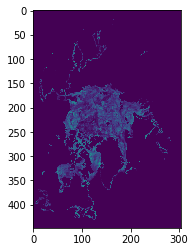


 92%|█████████▏| 11/12 [03:29<00:18, 18.32s/it]

(136192,)


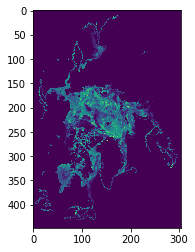


100%|██████████| 12/12 [03:48<00:00, 19.03s/it]

(136192,)


In [ ]:
for i in tqdm(range(12)):
  datan = globals()['mvtrain_{}'.format(i)]

  # 데이터셋 나누기
  x_train = datan[:9].reshape(9,-1).T
  y_train = datan[9].reshape(1,-1).T
  train_ds = lgb.Dataset(pd.DataFrame(x_train), label= pd.DataFrame(y_train))

  x_test = pd.DataFrame(datan[1:10].reshape(9,-1).T)

  # 모델 훈련
  params = {
            'learning_rate' : 0.05,
            'boosting_type': 'gbdt',
            'objective': 'tweedie',
            'tweedie_variance_power': 1.1,
            'metric': 'mae',
            'sub_row' : 0.75,
            'lambda_l2' : 0.1
        }
  model = lgb.train(params, train_ds, 1000)

  # 모델 예측
  predictions = model.predict(x_test)

  # 소숫점은 다 사라져 함수 생성
  # def fun(x) : 
  #   return np.round_(x, 0)

  # 그래프를 보자구
  matplotlib.pyplot.imshow(predictions.reshape(448,304), interpolation = 'None')
  matplotlib.pyplot.show()

  # 변수 저장
  globals()['pred{}'.format(i)] = predictions
  print(globals()['pred{}'.format(i)].shape)



  0%|          | 0/12 [00:00<?, ?it/s]

(136192,)


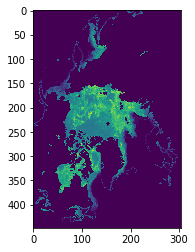


  8%|▊         | 1/12 [00:00<00:01,  8.54it/s]

(136192,)


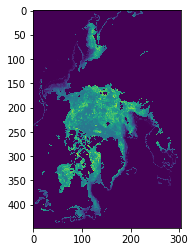


 17%|█▋        | 2/12 [00:00<00:01,  8.08it/s]

(136192,)


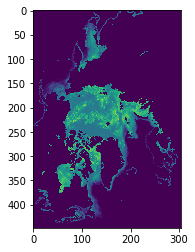


 25%|██▌       | 3/12 [00:00<00:01,  7.96it/s]

(136192,)


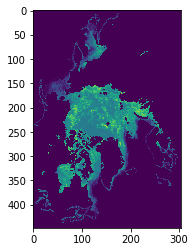


 33%|███▎      | 4/12 [00:00<00:01,  7.65it/s]

(136192,)


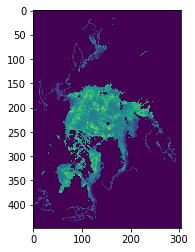


 42%|████▏     | 5/12 [00:00<00:00,  7.39it/s]

(136192,)


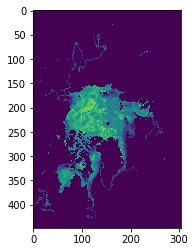


 50%|█████     | 6/12 [00:00<00:00,  7.27it/s]

(136192,)


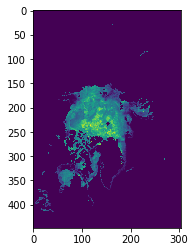


 58%|█████▊    | 7/12 [00:00<00:00,  7.19it/s]

(136192,)


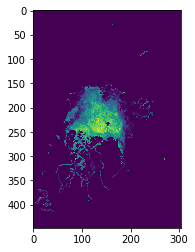


 67%|██████▋   | 8/12 [00:01<00:00,  7.22it/s]

(136192,)


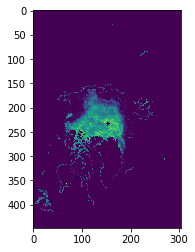


 75%|███████▌  | 9/12 [00:01<00:00,  7.18it/s]

(136192,)


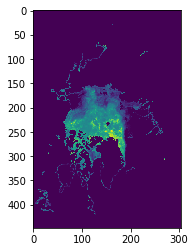


 83%|████████▎ | 10/12 [00:01<00:00,  7.18it/s]

(136192,)


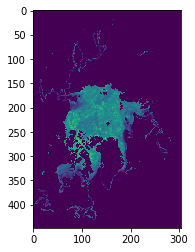


 92%|█████████▏| 11/12 [00:01<00:00,  7.21it/s]

(136192,)


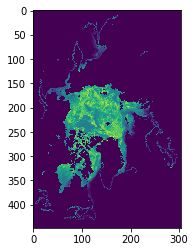


100%|██████████| 12/12 [00:01<00:00,  7.20it/s]


In [ ]:
# 변동성의 합
for i in tqdm(range(12)):
  ori = globals()['train{}'.format(i)][10].reshape(-1)
  pr = globals()['pred{}'.format(i)]

  globals()['mvpred_{}'.format(i)] = ori + pr
  print(globals()['mvpred_{}'.format(i)].shape)

  # 그래프를 보자구
  plt.imshow(globals()['mvpred_{}'.format(i)].reshape(448,304), interpolation = 'None')
  plt.show()

In [ ]:
train0.shape

(11, 448, 304)

In [ ]:
train0[10].shape

(448, 304)

In [ ]:
train0[:10].shape

(10, 448, 304)

In [ ]:
train0[1:11].shape

(10, 448, 304)

Xgboost 모델

[02:15:47] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


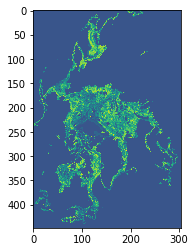

(136192,)
[02:16:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


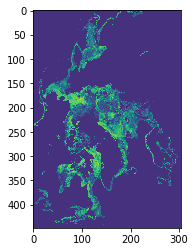

(136192,)
[02:16:52] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


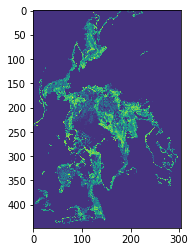

(136192,)
[02:17:25] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


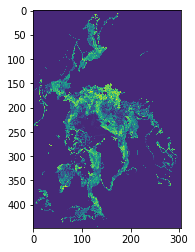

(136192,)
[02:17:58] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


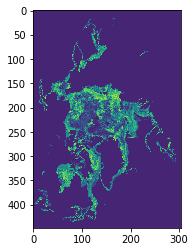

(136192,)
[02:18:31] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


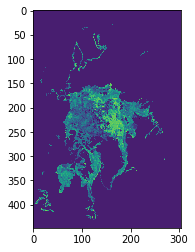

(136192,)
[02:19:04] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


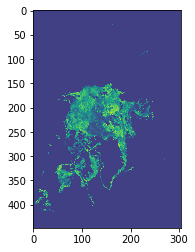

(136192,)
[02:19:36] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


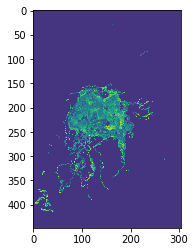

(136192,)
[02:20:08] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


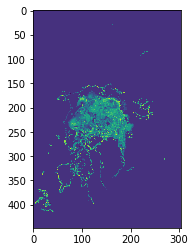

(136192,)
[02:20:41] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


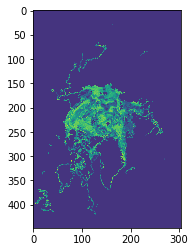

(136192,)
[02:21:13] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


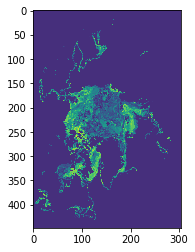

(136192,)
[02:21:46] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


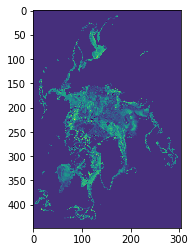

(136192,)


In [ ]:
for i in range(12):
  datan = globals()['mvtrain_{}'.format(i)]

  # 데이터셋 나누기
  x_train = datan[:3].reshape(3,-1).T
  y_train = datan[3].reshape(1,-1).T
  x_test = datan[1:4].reshape(3,-1).T

  # 모델 훈련
  xgb_model = xgb.XGBRegressor(n_estimators=500, learning_rate=0.07, gamma=1, subsample=0.75,
                               colsample_bytree=1, max_depth=7)
  xgb_model.fit(x_train,y_train)

  # 모델 예측
  predictions = xgb_model.predict(x_test)

  # 0.005미만은 다 사라져 함수 생성 - 소숫점 2째 자리에서 반올림
  # def fun(x) : 
  #   return np.round_(x, 0)

  # 그래프를 보자구
  matplotlib.pyplot.imshow( predictions.reshape(448,304), interpolation = 'None')
  matplotlib.pyplot.show()

  # 변수 저장
  globals()['pred{}'.format(i)] = predictions
  print(globals()['pred{}'.format(i)].shape)


  0%|          | 0/12 [00:00<?, ?it/s]

(136192,)


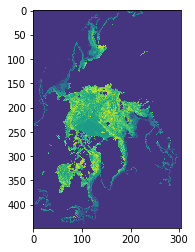

  8%|▊         | 1/12 [00:00<00:01,  7.74it/s]

(136192,)


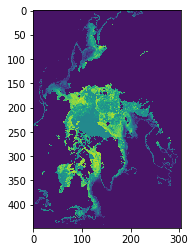

 17%|█▋        | 2/12 [00:00<00:01,  7.87it/s]

(136192,)


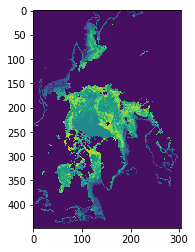

 25%|██▌       | 3/12 [00:00<00:01,  7.79it/s]

(136192,)


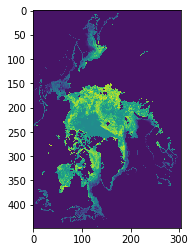

 33%|███▎      | 4/12 [00:00<00:01,  7.94it/s]

(136192,)


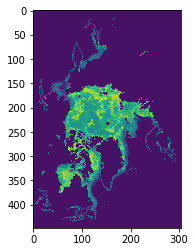

 42%|████▏     | 5/12 [00:00<00:01,  6.63it/s]

(136192,)


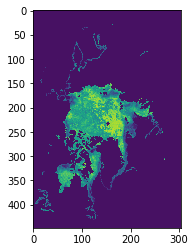

 50%|█████     | 6/12 [00:00<00:00,  7.11it/s]

(136192,)


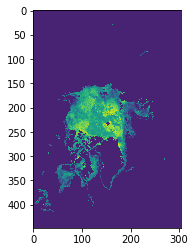

 58%|█████▊    | 7/12 [00:00<00:00,  7.44it/s]

(136192,)


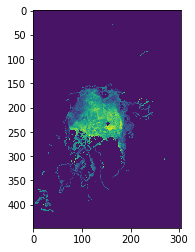

 67%|██████▋   | 8/12 [00:01<00:00,  7.57it/s]

(136192,)


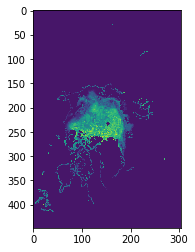

 75%|███████▌  | 9/12 [00:01<00:00,  7.50it/s]

(136192,)


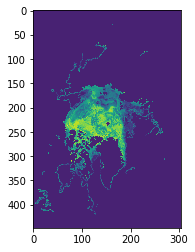

 83%|████████▎ | 10/12 [00:01<00:00,  7.35it/s]

(136192,)


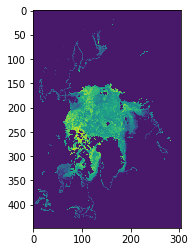

 92%|█████████▏| 11/12 [00:01<00:00,  7.39it/s]

(136192,)


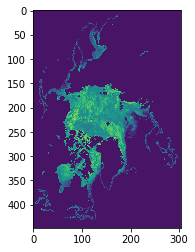

100%|██████████| 12/12 [00:01<00:00,  7.41it/s]


In [ ]:
# 변동성의 합 - XGB
for i in tqdm(range(12)):
  ori = globals()['train{}'.format(i)][4].reshape(-1)
  pr = globals()['pred{}'.format(i)]
  pr = fun(pr)

  globals()['mvpred_{}'.format(i)] = ori + pr
  print(globals()['mvpred_{}'.format(i)].shape)

  # 그래프를 보자구
  plt.imshow(globals()['mvpred_{}'.format(i)].reshape(448,304), interpolation = 'None')
  plt.show()

In [ ]:
# 그래프 함수
def show(npy):
    num_channel = npy.shape[0]
    plt.figure(figsize=(50, 50)) 
    for channel in range(num_channel):
      tmpimg = npy[channel, :, :]
      ax = plt.subplot(1, num_channel, channel+1)  # (행, 열, 데이터 개수) - 그리고 싶은 팜플렛
      ax.title.set_text("Ice")

      ax.imshow(tmpimg)
    plt.tight_layout()
    plt.show()
    plt.close()

In [ ]:
train3.shape

(11, 448, 304)

In [ ]:
# 소숫점 버리기
def fun(x) : 
  return np.trunc(x)

In [ ]:
mvpred_0.reshape(448,304)[250,200], train0[4][250,200]

(353.0469159662474, 219)

In [ ]:
# 예측 변동률
pred0.reshape(448,304)[250,200]

190.0469159662474

In [ ]:
mvtrain_0.shape

(10, 448, 304)

In [ ]:
# 전 값 훈련 데이터셋
mvtrain_0[9].reshape(448,304)[250,200]

139

In [ ]:
(train0[9] - train0[8])[250,200]

178

In [ ]:
train0[9][250,200], train0[8][250,200]

(24, 102)

In [ ]:
train0[8][250,200], train0[7][250,200]

(102, 205)

In [ ]:
train0[2][250,200], train0[1][250,200]

(187, 208)

In [ ]:
train0[1][250,200], train0[0][250,200]

(208, 182)

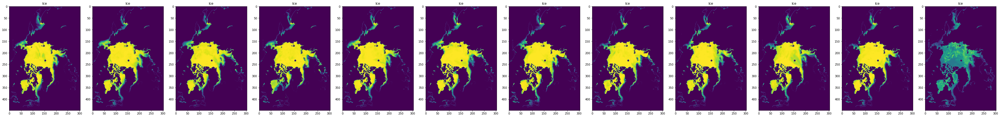

In [ ]:
show(np.concatenate((train0, mvpred_0.reshape(1,448,304))))

In [ ]:
(train9[4]-train9[3])

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

Text(0.5, 1.0, '웅 확인이여')

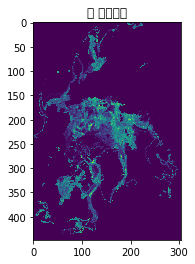

In [ ]:
import matplotlib.pyplot
matplotlib.pyplot.imshow(pred0.reshape(448,304), interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')

In [ ]:
pred0.reshape(448,304)[250,200]

190.0469159662474

Text(0.5, 1.0, '웅 확인이여')

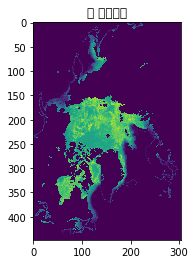

In [ ]:
import matplotlib.pyplot
matplotlib.pyplot.imshow((train0[10]+mvpred_0.reshape(448,304)).reshape(448,304), interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')

In [ ]:
# 제출 형태로 변환

# 데이터 생성
sh1 = pd.DataFrame(mvpred_0.reshape(1,-1))

for i in range(11):
  globals()['mvpred_{}'.format(i+1)] = globals()['mvpred_{}'.format(i+1)].reshape(1,-1)

  sh = globals()['mvpred_{}'.format(i+1)]
  sh = pd.DataFrame(sh)

  sh1 = pd.concat((sh1, sh), axis=0)
  print(sh1.shape)

(2, 136192)
(3, 136192)
(4, 136192)
(5, 136192)
(6, 136192)
(7, 136192)
(8, 136192)
(9, 136192)
(10, 136192)
(11, 136192)
(12, 136192)


In [ ]:
# 데이터 확인
sh1

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
0,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,...,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065,0.035065
0,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,...,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272,0.206272
0,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,...,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408,0.042408
0,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,...,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696,0.031696
0,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,...,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.003112,0.

In [ ]:
  def fun(x) : 
    return np.trunc(x)

In [ ]:
fun(sh1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# ReLU함수
def relu(x) : 
    return np.maximum(0, x)

In [ ]:
# sh1의 인덱스 수정

# 12개월, 24개월 투투
result = pd.concat([fun(sh1),fun(sh1)], axis=0)
result = result.reset_index(drop=True)

# 파일 제출
submission = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/sample_submission.csv")
sub = pd.concat([submission.loc[:,'month'],result], axis=1)
sub.columns = submission.columns.values  # 제출파일에서 컬럼명을 
sub.tail()

,month,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
19,2020-08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
20,2020-09,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21,2020-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22,2020-11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
23,2020-12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Text(0.5, 1.0, '웅 확인이여')

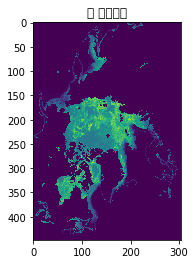

In [ ]:
check = np.array(sub.iloc[0,1:], dtype=np.float64).reshape(448,304)

import matplotlib.pyplot
matplotlib.pyplot.imshow(check, interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')

In [ ]:
# 제출
sub.to_csv('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/result/sub_0317_2_lgbm.csv', index = False)

------
> 알고리즘 만들기

In [ ]:
# 투입될 데이터셋
input = train0[0:3].reshape(3,-1).T  # ".T"를 통해 역순으로
input.shape

(136192, 3)

In [ ]:
input[:,0].reshape(448,304)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

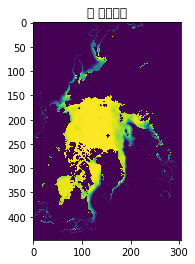

In [ ]:
# 전처리된 데이터 확인
import matplotlib.pyplot
matplotlib.pyplot.imshow(input[:,0].reshape(448,304), interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')
matplotlib.pyplot.show()

In [ ]:
# 회귀식 기울기: (0.58037145, 0.51338435), 절편: -0.05020452688138555
np.random.seed(4)  # 랜덤시드 고정

# 가중치
w1 = np.random.normal(0.5, 0.2, (136192,1))  # 평균, 분산, 크기
w2 = np.random.normal(0.5, 0.2, (136192,1))  # 평균, 분산, 크기
print("가중치 1 \n", w1)
print("\n 가중치 2 \n",w2)

# 절편
i1 = np.random.normal(- 0.05, 0.01, (136192,1))  # 평균, 분산, 크기
print("\n 절편 1 \n",i1)

가중치 1 
 [[0.51011234]
 [0.59999027]
 [0.30081821]
 ...
 [0.43702849]
 [0.69165379]
 [0.26842576]]

 가중치 2 
 [[0.74312217]
 [0.44178403]
 [0.30674265]
 ...
 [0.65128332]
 [0.32465774]
 [0.32115283]]

 절편 1 
 [[-0.03727928]
 [-0.05210135]
 [-0.0414228 ]
 ...
 [-0.0393923 ]
 [-0.06889602]
 [-0.03992706]]


In [ ]:
# 활성화 함수로 ReLU함수를 사용
def relu(x) : 
    return np.maximum(0, x)

In [ ]:
# 노드 계산 1
x1 = input[:,0].reshape(-1,1)
node1 = x1 * w1
node1 = relu(node1)  # 활성화함수 통과

x2 = input[:,1].reshape(-1,1)
node2 = x2 * w2
node2 = relu(node2)

output = node1 + node2 + i1 
output = relu(output)

print(output.shape)

(136192, 1)


In [ ]:
# 2
node1.shape, node2.shape, output.shape

((136192, 1), (136192, 1), (136192, 1))

> 전미분 계산법
* https://blog.naver.com/kmc7468/221898862253

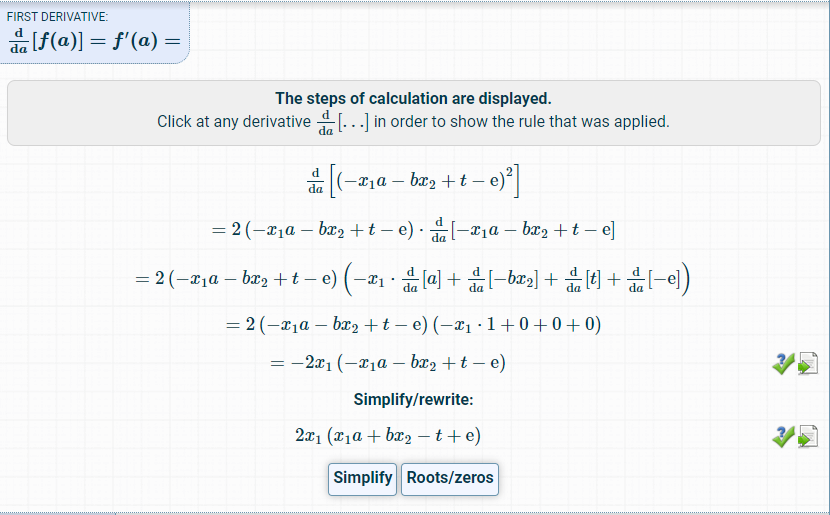

In [ ]:
# 역전파 가중치 계산1
real = input[:,2].reshape(-1,1)  # 실제값
error = real - output  # 실제 오차
T = real

# 미분 오차(전미분을 사용)
# 여기서 미분 오차를 위해 제곱을 사용했으므로 다시 루트로 풀어줘야지
dire = ((2*x1)*(x1*w1 + w2*x2 -T +i1)) + ((2*x2)*(x2*w2 + w1*x1 -T +i1))

# 편미분으로 노드당 부여 가중치 계산
e1rat = sum((2*x1)*(x1*w1 + w2*x2 -T +i1))/(sum((2*x1)*(x1*w1 + w2*x2 -T +i1)) + sum((2*x2)*(x2*w2 + w1*x1 -T +i1))) 
e2rat = sum((2*x2)*(x2*w2 + w1*x1 -T +i1))/(sum((2*x1)*(x1*w1 + w2*x2 -T +i1)) + sum((2*x2)*(x2*w2 + w1*x1 -T +i1))) 

# 편미분으로 역전파 가중치에 가중치부여
hid_e1 = e1rat * dire  # 알파 가중치 수정(x1) : 편미분 비율에 맞추어

hid_e2 = e2rat * dire  # 베타 가중치 수정(x2) : 편미분 비율에 맞추어

# 역전파 에러 형태 확인
hid_e1.shape, hid_e2.shape 

((136192, 1), (136192, 1))

--------------------
> 계산1의 실험

In [ ]:
w1 += lr * hid_e1

In [ ]:
# 실제 오차
real[500]

array([10], dtype=uint8)

In [ ]:
dire = np.sqrt(dire)

array([[-0.],
       [-0.],
       [-0.],
       ...,
       [-0.],
       [-0.],
       [-0.]])

In [ ]:
np.sqrt([1,-4,4])

array([ 1., nan,  2.])

In [ ]:
dire[500]

array([-122.09308889])

In [ ]:
# 실질적인 가중치
hid_e1[500]

array([-67.20264544])

In [ ]:
w1[500]

array([0.34312756])

In [ ]:
w1 += hid_e1

In [ ]:
w1[500]

array([-2449.99028177])

In [ ]:
import math
math.sqrt(2), math.sqrt(math.sqrt(2)), math.sqrt(math.sqrt(math.sqrt(2)))

(1.4142135623730951, 1.189207115002721, 1.0905077326652577)

In [ ]:
real = input[:,2].reshape(-1,1)  # 실제값
T = real - output  # 실제 오차

In [ ]:
T

array([[0.],
       [0.],
       [0.],
       ...,
       [0.],
       [0.],
       [0.]])

In [ ]:
hid_e1

array([[-0.],
       [-0.],
       [-0.],
       ...,
       [-0.],
       [-0.],
       [-0.]])

In [ ]:
w1.reshape(448,304)[200,200]

435.6184598530229

In [ ]:
w2.reshape(448,304)[200,200]

421.5190046372288

In [ ]:
pre.reshape(448,304)[200,200]

1.3826690759308147e+54

In [ ]:
input[:,2].reshape(448,304)[200,200]

245

In [ ]:
sum((2*x1)*(x1*w1 + w2*x2 -T +i1))/(sum((2*x1)*(x1*w1 + w2*x2 -T +i1)) + sum((2*x2)*(x2*w2 + w1*x1 -T +i1))) 

array([0.5081811])

In [ ]:
sum((2*x1)*(x1*w1 + w2*x2 -T +i1))

array([9.51582472e+08])

In [ ]:
sum((2*x2)*(x2*w2 + w1*x1 -T +i1))

array([9.20943815e+08])

In [ ]:
sum((2*x1)*(x1*w1 + w2*x2 -T +i1))/(sum((2*x1)*(x1*w1 + w2*x2 -T +i1)) + sum((2*x2)*(x2*w2 + w1*x1 -T +i1))) 

array([0.5081811])

In [ ]:
sum((2*x2)*(x2*w2 + w1*x1 -T +i1))/(sum((2*x1)*(x1*w1 + w2*x2 -T +i1)) + sum((2*x2)*(x2*w2 + w1*x1 -T +i1))) 

array([0.4918189])

> 실험 끝
----------

In [ ]:
# 역전파 가중치 계산2
lr = 0.1

# 가중치 업데이트
w1 += lr * hid_e1
w2 += lr * hid_e2

클래스 알고리즘 만들기

In [ ]:
class linearreg:

  ### 회귀 알고리즘 초기화 ###
  def __init__(self, inputnodes, learningrate, randomseed):
    # 변수 설정
    self.nodes = inputnodes
    self.lr = learningrate

    np.random.seed(randomseed)  # 랜덤시드 고정

    # 가중치
    self.w1 = np.random.normal(0.4, 0.01, (self.nodes,1))  # 평균, 분산, 크기
    self.w2 = np.random.normal(0.4, 0.01, (self.nodes,1)) 

    # 절편
    self.i1 = np.random.normal(- 0.05, 0.001, (self.nodes,1))  # 평균, 분산, 크기

    # 활성화 함수
    self.func = lambda x: np.maximum(0, x)


  ### 학습하드아 ###
  def train(self, input_narr, target_narr):
    # ax1
    x1 = input_narr[:,0].reshape(-1,1)
    node1 = x1 * self.w1
    node1 = self.func(node1)  # 활성화함수 통과

    # bx2
    x2 = input_narr[:,1].reshape(-1,1)
    node2 = x2 * self.w2
    node2 = self.func(node2)

    # out
    output = node1 + node2 + self.i1 
    output = self.func(output)

    # 역전파 가중치 계산1
    real = target_narr.reshape(-1,1)  # 실제값
    T = real - output  # 실제 오차

    # 미분 오차(전미분을 사용)
    dire = ((2*x1)*(x1*self.w1 + self.w2*x2 -T +self.i1)) + ((2*x2)*(x2*self.w2 + self.w1*x1 -T +self.i1))

    # 편미분으로 노드당 부여 가중치 계산
    e1rat = sum((2*x1)*(x1*self.w1 + self.w2*x2 -T +self.i1))/(sum((2*x1)*(x1*self.w1 + self.w2*x2 -T +self.i1)) + sum((2*x2)*(x2*self.w2 + self.w1*x1 -T +self.i1))) 
    e2rat = sum((2*x2)*(x2*self.w2 + self.w1*x1 -T +self.i1))/(sum((2*x1)*(x1*self.w1 + self.w2*x2 -T +self.i1)) + sum((2*x2)*(x2*self.w2 + self.w1*x1 -T +self.i1))) 

    # 편미분으로 역전파 가중치에 가중치부여
    hid_e1 = e1rat * dire  # 알파 가중치 수정(x1) : 편미분 비율에 맞추어
    hid_e2 = e2rat * dire  # 베타 가중치 수정(x2) : 편미분 비율에 맞추어

    # 가중치 업데이트
    self.w1 -= (self.lr * hid_e1)
    self.w2 -= (self.lr * hid_e2)


  ### 결과 예측 ###
  def predict(self, pred_narr):
    # 회귀식 첫항 계산
    x1 = pred_narr[:,0].reshape(-1,1)
    node1 = x1 * self.w1
    node1 = self.func(node1)  # 활성화함수 통과

    # 회귀식 둘째항 계산
    x2 = pred_narr[:,1].reshape(-1,1)
    node2 = x2 * self.w2
    node2 = self.func(node2)

    # 출력값 계산
    output = node1 + node2 + self.i1 
    output = self.func(output)

    return output

In [ ]:
model = linearreg(136192,0.001, 8)

In [ ]:
model.train(input, input[:,2])

In [ ]:
for i in tqdm(range(10)):
  model.train(input, input[:,2])

100%|██████████| 10/10 [00:05<00:00,  1.93it/s]


In [ ]:
model.predict(input[:,1:])

array([[0.],
       [0.],
       [0.],
       ...,
       [0.],
       [0.],
       [0.]])

In [ ]:
model.predict(input[:,1:]).shape

(136192, 1)

In [ ]:
pre = model.predict(input).T
pre.reshape(448,304)

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

* 가중치에 대해 다시 생각해봐야할듯
* 가중치를 재 고민!!! 이 필수

> 보니까
* +인것은 +로만 되네....
* - 인것도 +로 하네...

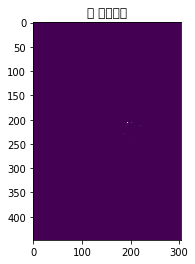

In [ ]:
pre = model.predict(input).T

# 훈련된 알고리즘 확인
import matplotlib.pyplot
matplotlib.pyplot.imshow(pre.reshape(448,304), interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')
matplotlib.pyplot.show()

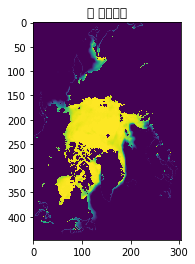

In [ ]:
# 훈련 데이터 확인
import matplotlib.pyplot
matplotlib.pyplot.imshow(input[:,2].reshape(448,304), interpolation = 'None')
matplotlib.pyplot.title('웅 확인이여')
matplotlib.pyplot.show()

In [ ]:
model.train(input, input[:,2])

In [ ]:
import math
pre = model.predict(input).T
pre.reshape(448,304)[430,100]

1.902332908928926

In [ ]:
input[:,2].reshape(448,304)[430,100]

8

----
> 실험

In [ ]:
func = lambda x: np.maximum(0, x)

In [ ]:
input

array([[0, 0, 0],
       [0, 0, 0],
       [0, 0, 0],
       ...,
       [0, 0, 0],
       [0, 0, 0],
       [0, 0, 0]], dtype=uint8)

> 실험 끝
____

In [ ]:
# 예시로 1개의 데이터와 3*3*3의 맵
# 3차원의 맵을 의미
# 3개의 데이터는 2개의 속성을 가짐

input = numpy.random.normal(3.0, 5.0, (3,2))
input = input.T  # 행과 열을 바꾸어서 한 데이터의 속성 값이 노드로 들어감


# 가중치
w1 = numpy.random.normal(1.0, 0.5, (3,3,2))

In [ ]:
# 계산 수행
# 결론적으로 노드가 행으로 나오고 데이터는 열로 나오도록 구성
# 행렬 곱셈에서 노드수가 앞에, 들어가는 데이터수가 뒤로 두기
import numpy as np
node1 = np.dot(w1, input)


In [ ]:
node1

array([[[11.61309726,  8.82293913, 13.31404688],
        [ 8.64285734,  6.29301326, 11.38578202],
        [ 1.42026464,  0.4146287 ,  5.2187956 ]],

       [[ 8.59658991,  5.71109527, 14.28752274],
        [ 8.42095433,  5.74949762, 13.15752188],
        [ 4.80212908,  3.12511651,  8.33321295]],

       [[13.78790535, 10.20573764, 17.26375309],
        [ 6.19468189,  3.3866994 , 14.23353652],
        [ 6.21485618,  3.55735772, 13.41724017]]])

In [ ]:
    # 오차
    output_errors = targets - final_outputs
    # 가중치에 의해 나눈 오차들을 계산
    hidden_errors = numpy.dot(self.who.T, output_errors)

    # 가중치 업데이트
    # 은닉, 출력
    self.who += self.lr * numpy.dot((output_errors*final_outputs*(1.0-final_outputs)), numpy.transpose(hidden_outputs))
    # 입력, 은닉
    self.wih += self.lr * numpy.dot((hidden_errors*hidden_outputs*(1.0-hidden_outputs)), numpy.transpose(inputs))


> 알고리즘 만들기 끝
---------

----
> 뚱땅뚱땅

In [ ]:
vec = train0
a = vec.reshape(10,136192)
lda = pd.DataFrame(a.T)
lda.iloc[:,9]

0         0
1         0
2         0
3         0
4         0
         ..
136187    0
136188    0
136189    0
136190    0
136191    0
Name: 9, Length: 136192, dtype: uint8

In [ ]:
lda.iloc[0, :9]

0    0
1    0
2    0
3    0
4    0
5    0
6    0
7    0
8    0
Name: 0, dtype: uint8

In [ ]:
lda.iloc[i,9]

0

In [ ]:
x_tr = lda.iloc[:2, :9]
y_tr = lda.iloc[:2,9]
x_test = lda.iloc[:2,1:]

  
# 모델 훈련
mod = LinearRegression()
mod.fit(x_tr, y_tr) 
print(mod.predict(x_test))

[0. 0.]


In [ ]:
lda.iloc[:2,9]

0    0
1    0
Name: 9, dtype: uint8

In [ ]:
lda.iloc[:2, :9]

,0,1,2,3,4,5,6,7,8
0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0


In [ ]:
lda.iloc[:2,1:]

,1,2,3,4,5,6,7,8,9
0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0


In [ ]:
pd.DataFrame(mod.predict(x_test))

,0
0,0.0
1,0.0


In [ ]:
for i in range(68096):
  x_tr = lda.iloc[:2, :9]
y_tr = lda.iloc[:2,9]
x_test = lda.iloc[:2,1:]

In [ ]:
for i in range(2):
  x_tr = lda.iloc[(68096*i):(68096*(i+1)), :9]
  print("\n",x_tr)


        0  1  2  3  4  5  6  7  8
0      0  0  0  0  0  0  0  0  0
1      0  0  0  0  0  0  0  0  0
2      0  0  0  0  0  0  0  0  0
3      0  0  0  0  0  0  0  0  0
4      0  0  0  0  0  0  0  0  0
...   .. .. .. .. .. .. .. .. ..
68091  0  0  0  0  0  0  0  0  0
68092  0  0  0  0  0  0  0  0  0
68093  0  0  0  0  0  0  0  0  0
68094  0  0  0  0  0  0  0  0  0
68095  0  0  0  0  0  0  0  0  0

[68096 rows x 9 columns]

         0  1  2  3  4  5  6  7  8
68096   0  0  0  0  0  0  0  0  0
68097   0  0  0  0  0  0  0  0  0
68098   0  0  0  0  0  0  0  0  0
68099   0  0  0  0  0  0  0  0  0
68100   0  0  0  0  0  0  0  0  0
...    .. .. .. .. .. .. .. .. ..
136187  0  0  0  0  0  0  0  0  0
136188  0  0  0  0  0  0  0  0  0
136189  0  0  0  0  0  0  0  0  0
136190  0  0  0  0  0  0  0  0  0
136191  0  0  0  0  0  0  0  0  0

[68096 rows x 9 columns]


In [ ]:
x_tr = lda.iloc[:45600, :9]
print("\n",x_tr)

x_tr = lda.iloc[45600:(45600+60800), :9]
print("\n",x_tr)

x_tr = lda.iloc[(45600+60800):, :9]
print("\n",x_tr)


        0  1  2  3  4  5  6  7  8
0      0  0  0  0  0  0  0  0  0
1      0  0  0  0  0  0  0  0  0
2      0  0  0  0  0  0  0  0  0
3      0  0  0  0  0  0  0  0  0
4      0  0  0  0  0  0  0  0  0
...   .. .. .. .. .. .. .. .. ..
45595  0  0  0  0  0  0  0  0  0
45596  0  0  0  0  0  0  0  0  0
45597  0  0  0  0  0  0  0  0  0
45598  0  0  0  0  0  0  0  0  0
45599  0  0  0  0  0  0  0  0  0

[45600 rows x 9 columns]

         0  1  2  3  4  5  6  7  8
45600   0  0  0  0  0  0  0  0  0
45601   0  0  0  0  0  0  0  0  0
45602   0  0  0  0  0  0  0  0  0
45603   0  0  0  0  0  0  0  0  0
45604   0  0  0  0  0  0  0  0  0
...    .. .. .. .. .. .. .. .. ..
106395  0  0  0  0  0  0  0  0  0
106396  0  0  0  0  0  0  0  0  0
106397  0  0  0  0  0  0  0  0  0
106398  0  0  0  0  0  0  0  0  0
106399  0  0  0  0  0  0  0  0  0

[60800 rows x 9 columns]

         0  1  2  3  4  5  6  7  8
106400  0  0  0  0  0  0  0  0  0
106401  0  0  0  0  0  0  0  0  0
106402  0  0  0  0  0  0  0  0  0
10

In [ ]:
01.23.45

In [ ]:
# 데이터 회귀 사용
# 함수 사용
from sklearn.linear_model import LinearRegression

pred = []

for i in tqdm(range(4)):
  # 훈련, 테스트 데이터 생성
  x_tr = lda.iloc[(2*i):(2*i+2), :9]
  y_tr = lda.iloc[(2*i):(2*i+2), 9]
  
  # 모델 훈련
  mod = LinearRegression()
  mod.fit(x_tr, y_tr) 
  x_test = lda.iloc[(2*i):(2*i+2), 1:]

  p1 = mod.predict(x_test)
  pred.append(p1)

100%|██████████| 68096/68096 [01:50<00:00, 613.59it/s]


In [ ]:
pd.DataFrame(np.array(pred).reshape(-1))

,0
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0
...,...
136187,0.0
136188,0.0
136189,0.0
136190,0.0


In [ ]:
np.array(pred).shape

(68096, 2)

In [ ]:
np.array(pred).reshape(448,304)

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
x_tr = lda.iloc[:45600, :9]
print("\n",x_tr)

x_tr = lda.iloc[45600:(45600+60800), :9]
print("\n",x_tr)

x_tr = lda.iloc[(45600+60800):, :9]
print("\n",x_tr)

In [ ]:
pred = []

x_tr1 = lda.iloc[:45600, :9]
x_tr2 = lda.iloc[45600:(45600+60800), :9]
x_tr3 = lda.iloc[(45600+60800):, :9]
y_tr1 = lda.iloc[:45600, 9]
y_tr2 = lda.iloc[45600:(45600+60800), 9]
y_tr3 = lda.iloc[(45600+60800):, 9]
  
# 모델 훈련
for j in range(3):
  x_tr = globals()['x_tr{}'.format(j+1)]
  y_tr = globals()['y_tr{}'.format(j+1)]

  mod = LinearRegression()
  mod.fit(x_tr, y_tr) 

  x_test1 = lda.iloc[:45600, 1:]
  x_test2 = lda.iloc[45600:(45600+60800), 1:]
  x_test3 = lda.iloc[(45600+60800):, 1:]

  x_test = globals()['x_test{}'.format(j+1)]
  p1 = mod.predict(x_test)

  print(np.array(p1).shape)

  pred.extend(p1)

  print(np.array(pred).shape)

  print(pred)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



> list.append(x)는 리스트 끝에 x 1개를 그대로 넣습니다.

> list.extend(iterable)는 리스트 끝에 가장 바깥쪽 iterable의 모든 항목을 넣습니다.

* https://m.blog.naver.com/wideeyed/221541104629

In [ ]:
np.array(pred).shape

(136192,)

In [ ]:
pred = []
p1 = mod.predict(x_test1)
p2 = mod.predict(x_test2)

pred.append(p1)
pred.append(p2)
np.array(pred).shape

(2,)

In [ ]:
pd.DataFrame(pred)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,60760,60761,60762,60763,60764,60765,60766,60767,60768,60769,60770,60771,60772,60773,60774,60775,60776,60777,60778,60779,60780,60781,60782,60783,60784,60785,60786,60787,60788,60789,60790,60791,60792,60793,60794,60795,60796,60797,60798,60799
0,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,-0.081973,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,4.653355,15.699257,8.113909,4.596957,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.594876,-0.301826,-0.008776,0.430800,1.016900,1.476798,1.896803,2.076697,0.365660,...,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,15.208863,8.299729,5.551903,-0.961189,-0.961189,-0.961189,-0.961189,31.106074,20.167588,1.692849,-0.396685,4.702652,14.443472,7.334973,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189,-0.961189
2,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,-0.117343,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# 예시로 1개의 데이터와 3*3*3의 맵
# 3차원의 맵을 의미
# 3개의 데이터는 2개의 속성을 가짐

input = numpy.random.normal(3.0, 5.0, (3,2))
input = input.T  # 행과 열을 바꾸어서 한 데이터의 속성 값이 노드로 들어감


# 가중치
w1 = numpy.random.normal(1.0, 0.5, (3,3,2))

In [ ]:
# 계산 수행
# 결론적으로 노드가 행으로 나오고 데이터는 열로 나오도록 구성
# 행렬 곱셈에서 노드수가 앞에, 들어가는 데이터수가 뒤로 두기
import numpy as np
node1 = np.dot(w1, input)


In [ ]:
node1

array([[[11.61309726,  8.82293913, 13.31404688],
        [ 8.64285734,  6.29301326, 11.38578202],
        [ 1.42026464,  0.4146287 ,  5.2187956 ]],

       [[ 8.59658991,  5.71109527, 14.28752274],
        [ 8.42095433,  5.74949762, 13.15752188],
        [ 4.80212908,  3.12511651,  8.33321295]],

       [[13.78790535, 10.20573764, 17.26375309],
        [ 6.19468189,  3.3866994 , 14.23353652],
        [ 6.21485618,  3.55735772, 13.41724017]]])

In [ ]:
    # 오차
    output_errors = targets - final_outputs
    # 가중치에 의해 나눈 오차들을 계산
    hidden_errors = numpy.dot(self.who.T, output_errors)

    # 가중치 업데이트
    # 은닉, 출력
    self.who += self.lr * numpy.dot((output_errors*final_outputs*(1.0-final_outputs)), numpy.transpose(hidden_outputs))
    # 입력, 은닉
    self.wih += self.lr * numpy.dot((hidden_errors*hidden_outputs*(1.0-hidden_outputs)), numpy.transpose(inputs))


> 뚱땅뚱땅 여기까지
-----

In [ ]:
########################################################################
# 데이터 회귀 사용
# 함수 사용
from sklearn.linear_model import LinearRegression

for i in range(12):
  print('\n', "야ㅇ이야: %s" % i)
  vec = globals()['train{}'.format(i)]
  a = vec.reshape(3,136192)
  lda = pd.DataFrame(a.T)

  # 변수 설정
  globals()['pred_{}'.format(i)] = []

  # 훈련 데이터, 테스트 데이터
  x_tr1 = lda.iloc[:45600, :2]
  x_tr2 = lda.iloc[45600:(45600+60800), :2]
  x_tr3 = lda.iloc[(45600+60800):, :2]
  y_tr1 = lda.iloc[:45600, 2]
  y_tr2 = lda.iloc[45600:(45600+60800), 2]
  y_tr3 = lda.iloc[(45600+60800):, 2]
  
  # 모델 훈련
  for j in range(3):
    x_tr = globals()['x_tr{}'.format(j+1)]
    y_tr = globals()['y_tr{}'.format(j+1)]

    mod = LinearRegression()
    mod.fit(x_tr, y_tr) 

    x_test1 = lda.iloc[:45600, 1:]
    x_test2 = lda.iloc[45600:(45600+60800), 1:]
    x_test3 = lda.iloc[(45600+60800):, 1:]

    x_test = globals()['x_test{}'.format(j+1)]
    p1 = mod.predict(x_test)

    globals()['pred_{}'.format(i)].extend(p1)


  # 파일 만들기
  globals()['pred_{}'.format(i)] = np.array(globals()['pred_{}'.format(i)]).reshape(1,448,304)

  print(globals()['pred_{}'.format(i)].shape)


 야ㅇ이야: 0
(1, 448, 304)

 야ㅇ이야: 1
(1, 448, 304)

 야ㅇ이야: 2
(1, 448, 304)

 야ㅇ이야: 3
(1, 448, 304)

 야ㅇ이야: 4
(1, 448, 304)

 야ㅇ이야: 5
(1, 448, 304)

 야ㅇ이야: 6
(1, 448, 304)

 야ㅇ이야: 7
(1, 448, 304)

 야ㅇ이야: 8
(1, 448, 304)

 야ㅇ이야: 9
(1, 448, 304)

 야ㅇ이야: 10
(1, 448, 304)

 야ㅇ이야: 11
(1, 448, 304)


-------
> 다중선형회귀모델 설명
* http://hleecaster.com/ml-linear-regression-example/
* ".coef_"는 기울기, ".intercept_"는 절편

In [ ]:
# 모델 파라미터값 확인
mod.coef_, mod.intercept_

(array([0.58037145, 0.51338435]), -0.05020452688138555)

-----

In [ ]:
# 예측된 변수 확인
for i in range(12):
  print(globals()['pred_{}'.format(i)].shape)

(1, 448, 304)
(1, 448, 304)
(1, 448, 304)
(1, 448, 304)
(1, 448, 304)
(1, 448, 304)
(1, 448, 304)
(1, 448, 304)
(1, 448, 304)
(1, 448, 304)
(1, 448, 304)
(1, 448, 304)


------
그래프 확인

In [ ]:
pred_0

array([[[-0.18062126, -0.18062126, -0.18062126, ..., -0.18062126,
         -0.18062126, -0.18062126],
        [-0.18062126, -0.18062126, -0.18062126, ..., -0.18062126,
         -0.18062126, -0.18062126],
        [-0.18062126, -0.18062126, -0.18062126, ..., -0.18062126,
         -0.18062126, -0.18062126],
        ...,
        [ 0.38011819,  0.38011819,  0.38011819, ...,  0.38011819,
          0.38011819,  0.38011819],
        [ 0.38011819,  0.38011819,  0.38011819, ...,  0.38011819,
          0.38011819,  0.38011819],
        [ 0.38011819,  0.38011819,  0.38011819, ...,  0.38011819,
          0.38011819,  0.38011819]]])

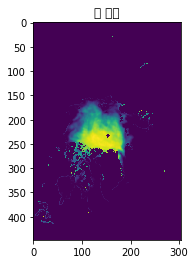

In [ ]:
# 그래프 그려보기
import matplotlib.pyplot
matplotlib.pyplot.imshow(relu(pred_7)[0], interpolation = 'None')
matplotlib.pyplot.title('웅 예측')
matplotlib.pyplot.show()

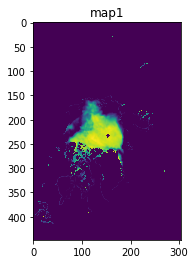

In [ ]:
# 원본 데이터
import matplotlib.pyplot
matplotlib.pyplot.imshow(train7[9], interpolation = 'None')
matplotlib.pyplot.title('map1')
matplotlib.pyplot.show()

In [ ]:
# 그래프 함수
def show(npy):
    num_channel = npy.shape[0]
    plt.figure(figsize=(50, 50)) 
    for channel in range(num_channel):
      tmpimg = npy[channel, :, :]
      ax = plt.subplot(1, num_channel, channel+1)  # (행, 열, 데이터 개수) - 그리고 싶은 팜플렛
      ax.title.set_text("Ice")

      ax.imshow(tmpimg)
    plt.tight_layout()
    plt.show()
    plt.close()

In [ ]:
np.concatenate((train11, relu(pred_11))).shape

(11, 448, 304)

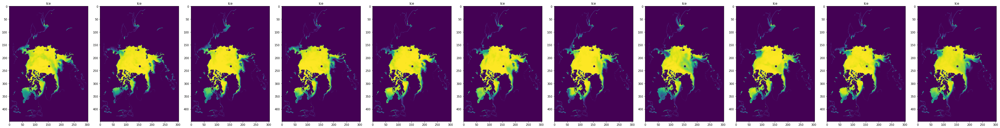

In [ ]:
show(np.concatenate((train11, relu(pred_11))))

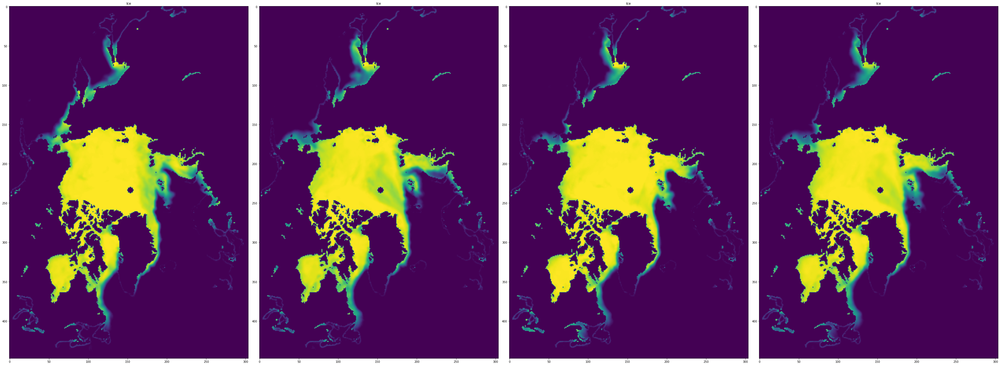

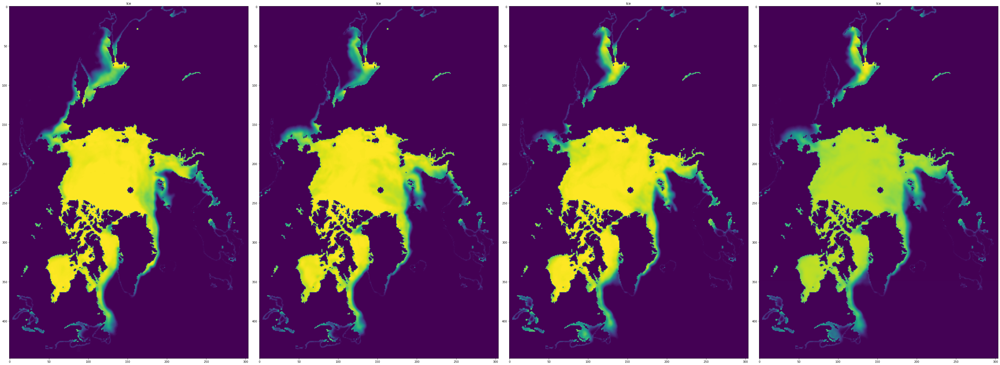

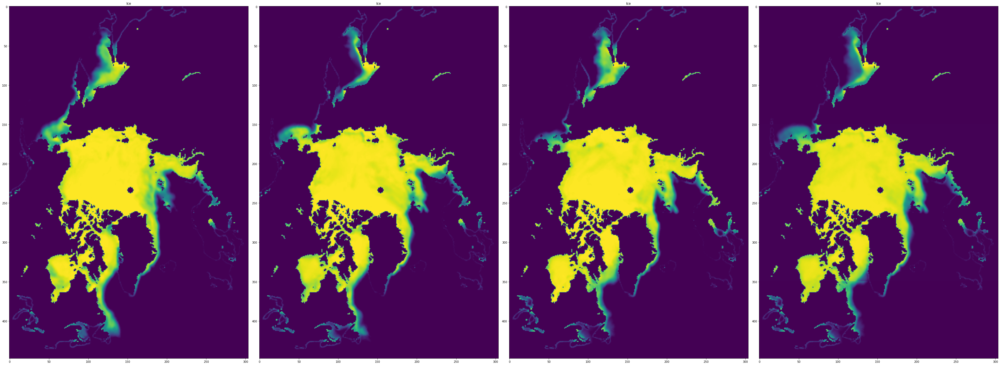

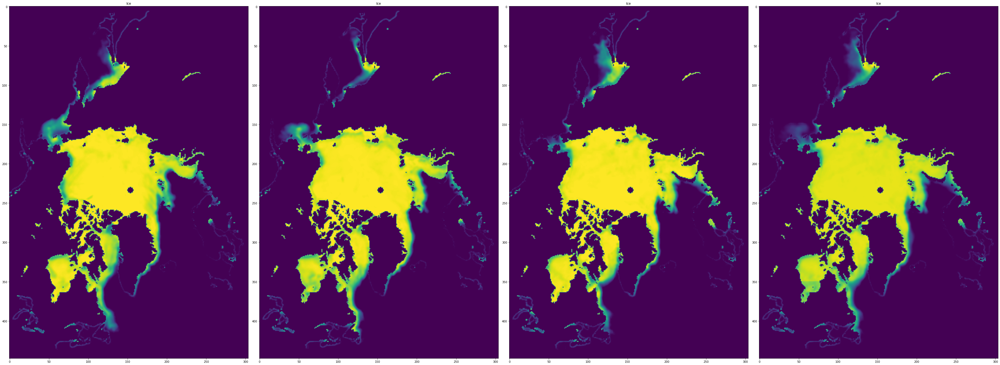

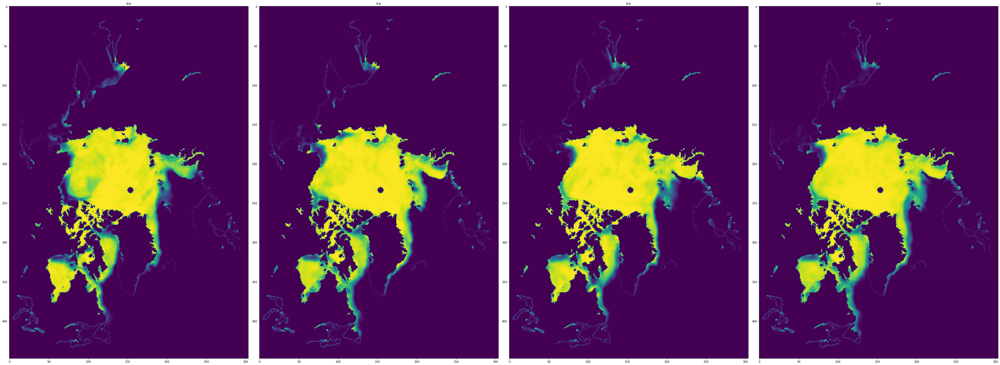

...

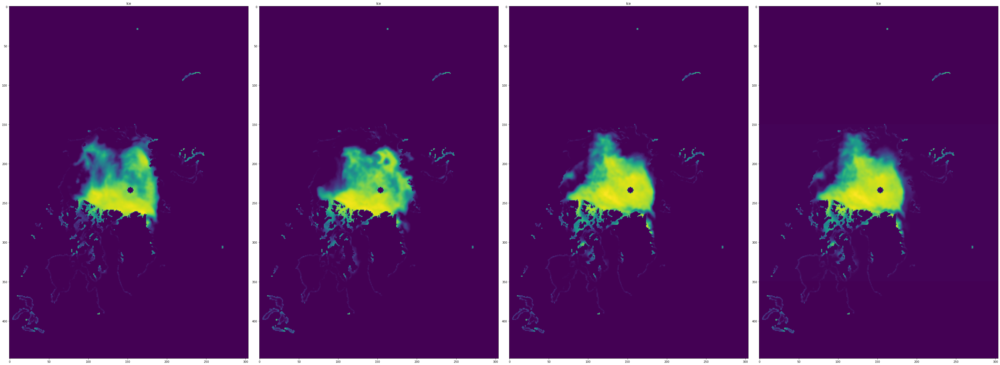

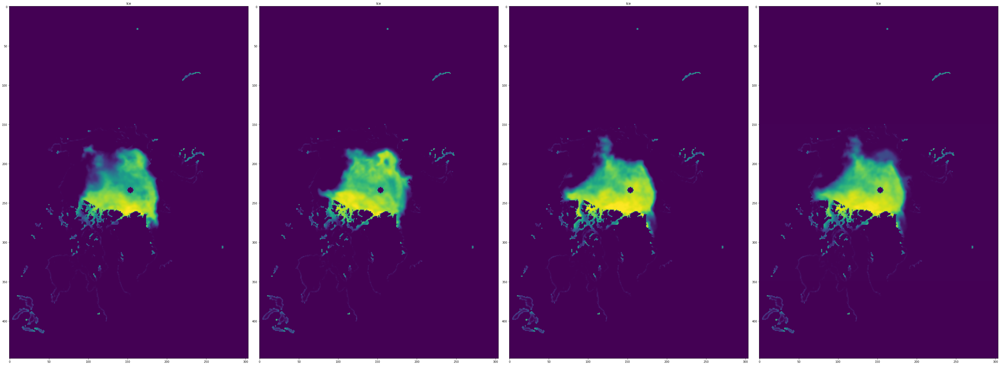

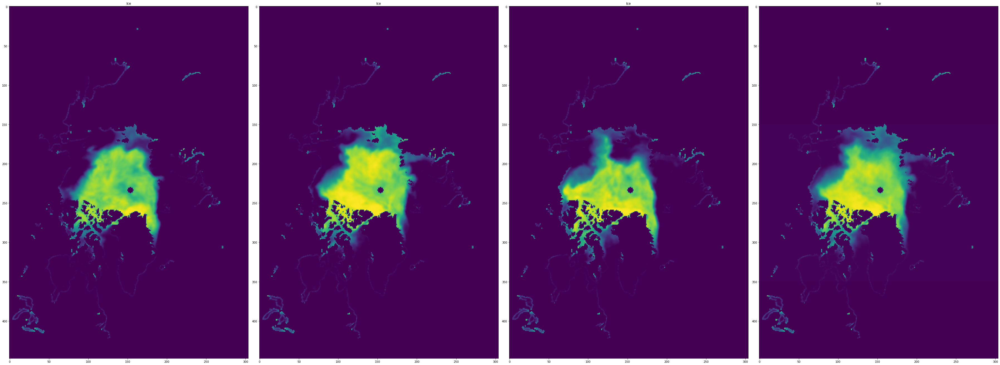

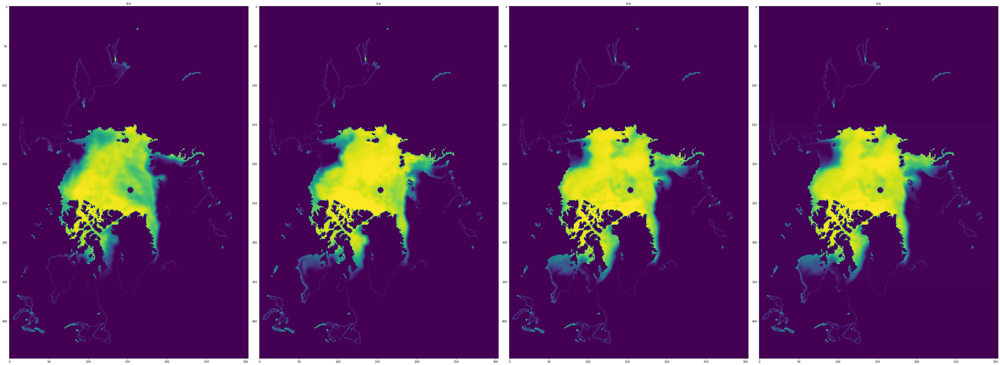

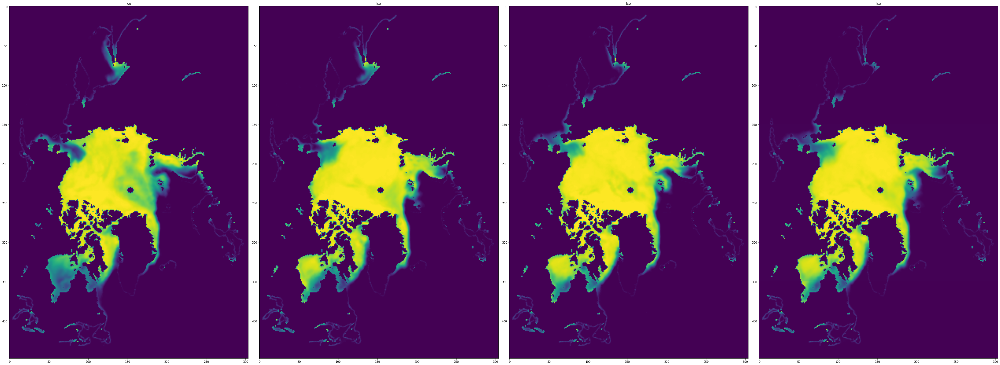

In [ ]:
for i in range(12):
  data_dd = globals()['train{}'.format(i)]
  pred_dd = relu(globals()['pred_{}'.format(i)])

  show(np.concatenate((data_dd, pred_dd)))

> 그래프 확인 여기까지
----

In [ ]:
# 제출 형태로 변환

# 데이터 생성
sh1 = pd.DataFrame(pred_0.reshape(1,-1))

for i in range(11):
  sh = globals()['pred_{}'.format(i+1)].reshape(1,-1)
  sh = pd.DataFrame(sh)

  sh1 = pd.concat((sh1, sh), axis=0)
  print(sh1.shape)

(2, 136192)
(3, 136192)
(4, 136192)
(5, 136192)
(6, 136192)
(7, 136192)
(8, 136192)
(9, 136192)
(10, 136192)
(11, 136192)
(12, 136192)


In [ ]:
# sh1의 인덱스 수정

# 12개월, 24개월 투투
result = pd.concat([sh1,sh1], axis=0)
result = result.reset_index(drop=True)

result.tail()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
19,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,0.001950,...,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349,-0.003349
20,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,0.000093,...,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182,0.012182
21,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,0.000097,...,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981,-0.004981
22,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,-0.005681,...,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284,0.053284
23,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,0.138597,...,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,-0.050205,

> 활성화 함수(ReLU)를 통과
* https://3months.tistory.com/64

In [ ]:
# ReLU함수
def relu(x) : 
    return np.maximum(0, x)

In [ ]:
sub1 = relu(sub.iloc[:,1:])
sub1.tail()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
19,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,...,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925
20,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,...,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851
21,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
22,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905
23,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000

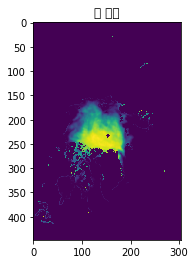

In [ ]:
# 제출본 그래프 그려보기
# 변수 설정 (사진으로)
see = np.array(sub1.iloc[7,:]).reshape(448,304)

import matplotlib.pyplot
matplotlib.pyplot.imshow(see, interpolation = 'None')
matplotlib.pyplot.title('웅 예측')
matplotlib.pyplot.show()

In [ ]:
# 제출 파일을 불러와 합치기
submission = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/sample_submission.csv")
sub = pd.concat([submission.loc[:,'month'],sub1], axis=1)
sub.columns = submission.columns.values  # 제출파일에서 컬럼명을 
sub.tail()

,month,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
19,2020-08,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,0.000021,...,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925,0.006925
20,2020-09,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,0.000086,...,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851,0.011851
21,2020-10,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,0.000551,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
22,2020-11,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905,0.015905
23,2020-12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000

In [ ]:
# 제출
sub.to_csv('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/result/sub_0311_4.csv', index = False)

일단 여러번 나누어서 회귀를 실행